##Importing Required Libraries

In [ ]:
import shutil
import os

import seaborn as sns
import matplotlib.pyplot as plt

from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np
from PIL import Image

from sklearn.metrics.pairwise import cosine_similarity

from tensorflow.keras.models import Model

from operator import itemgetter

##Mounting Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Define paths
drive_path = '/content/drive/MyDrive'
PizzaOrSandwich_drive_path = os.path.join(drive_path, 'PizzaOrSandwich')
training_drive_path = os.path.join(PizzaOrSandwich_drive_path, 'Train')
test_drive_path = os.path.join(PizzaOrSandwich_drive_path, 'Test')

# Define paths in Colab
colab_path = '/content'
PizzaOrSandwich_colab_path = os.path.join(colab_path, 'PizzaOrSandwich')
training_colab_path = os.path.join(PizzaOrSandwich_colab_path, 'Train')
test_colab_path = os.path.join(PizzaOrSandwich_colab_path, 'Test')

# Copy folders from Drive to Colab
shutil.copytree(training_drive_path, training_colab_path)
shutil.copytree(test_drive_path, test_colab_path)

# Display the paths
print("Training path:", training_colab_path)
print("Test path:", test_colab_path)

Training path: /content/PizzaOrSandwich/Train
Test path: /content/PizzaOrSandwich/Test


In [ ]:
# Collect the class names.
class_names = sorted(os.listdir(training_colab_path))
n_classes = len(class_names)
root_dir = 'PizzaOrSandwich/Train'

# Print
print("No. Classes : {}".format(n_classes))
print("Classes     : {}".format(class_names))

No. Classes : 2
Classes     : ['Pizza', 'Sandwich']


<ipython-input-5-3cdb4c0ff867>:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(class_distribution.keys()), y=list(class_distribution.values()), palette='bright')


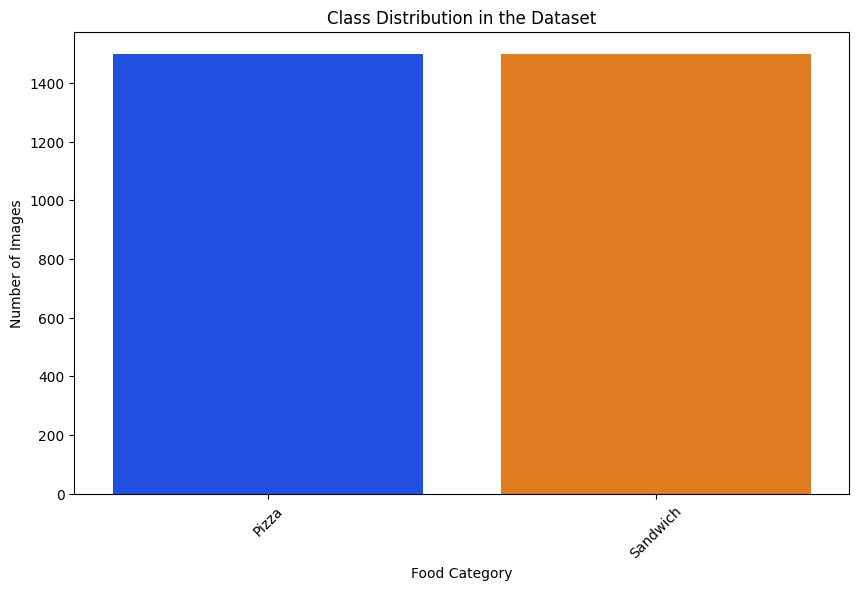

In [ ]:
# Load the dataset into a list of (image_path, label) tuples
dataset = []
for folder in class_names:
    folder_path = os.path.join(root_dir, folder)
    for img in os.listdir(folder_path):
        dataset.append((os.path.join(folder_path, img), folder))

# Create a dictionary for class distribution
class_distribution = {cls: len([img for img, label in dataset if label == cls]) for cls in class_names}

# Plot the class distribution
plt.figure(figsize=(10, 6))
sns.barplot(x=list(class_distribution.keys()), y=list(class_distribution.values()), palette='bright')
plt.title('Class Distribution in the Dataset')
plt.xticks(rotation=45)  # Rotate labels to fit longer names
plt.xlabel('Food Category')
plt.ylabel('Number of Images')
plt.show()

In [ ]:
# Initialize the ImageDataGenerator class
# Rescale all images by 1./255 and set aside 20% of the train images for validation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,  # Optional: Data Augmentation parameters can be added here
)

# Setup the training dataset generator
train_generator = train_datagen.flow_from_directory(
    training_colab_path,  # This is the path to the training data
    target_size=(150, 150),  # All images will be resized to 150x150
    batch_size=32,
    class_mode='binary',  # Binary classification, pizza or sandwich
    subset='training'  # Specify this generator is for training
)

# Setup the validation dataset generator
validation_generator = train_datagen.flow_from_directory(
    training_colab_path,  # Same directory as training data
    target_size=(150, 150),
    batch_size=32,
    class_mode='binary',
    subset='validation'  # Specify this generator is for validation
)

Found 2400 images belonging to 2 classes.
Found 600 images belonging to 2 classes.


## Creating CNN Architecture

In [ ]:
model = Sequential([
    # Convolutional layer 1
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    MaxPooling2D(2, 2),

    # Convolutional layer 2
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),

    # Convolutional layer 3
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),

    # Flattening the 2D arrays for fully connected layers
    Flatten(),
    Dropout(0.5),  # Dropout for regularization
    Dense(512, activation='relu'),
    Dense(1, activation='sigmoid')  # Sigmoid activation for binary classification
])

# Display the model's architecture
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 74, 74, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 36, 36, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 17, 17, 128)       0

In [ ]:
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=50,  # Total number of steps (batches of samples) before declaring one epoch finished and starting the next epoch.
    epochs=20,  # Number of epochs to train the model. An epoch is an iteration over the entire data provided.
    validation_data=validation_generator,
    validation_steps=12  # Total number of steps (batches of samples) to draw before stopping when performing validation at the end of every epoch.
)

Epoch 1/20
50/50 [==============================] - 9s 45ms/step - loss: 0.8532 - accuracy: 0.5200 - val_loss: 0.6346 - val_accuracy: 0.7161
Epoch 2/20
50/50 [==============================] - 2s 41ms/step - loss: 0.6312 - accuracy: 0.6669 - val_loss: 0.5205 - val_accuracy: 0.7734
Epoch 3/20
50/50 [==============================] - 2s 41ms/step - loss: 0.5575 - accuracy: 0.7269 - val_loss: 0.4758 - val_accuracy: 0.7865
Epoch 4/20
50/50 [==============================] - 2s 42ms/step - loss: 0.5099 - accuracy: 0.7588 - val_loss: 0.4318 - val_accuracy: 0.8125
Epoch 5/20
50/50 [==============================] - 2s 41ms/step - loss: 0.4792 - accuracy: 0.7819 - val_loss: 0.4056 - val_accuracy: 0.8333
Epoch 6/20
50/50 [==============================] - 2s 41ms/step - loss: 0.4274 - accuracy: 0.8175 - val_loss: 0.5388 - val_accuracy: 0.7630
Epoch 7/20
50/50 [==============================] - 2s 41ms/step - loss: 0.4079 - accuracy: 0.8181 - val_loss: 0.4787 - val_accuracy: 0.7760
Epoch 8/20
50

## Test Accuracy

In [ ]:
test_datagen = ImageDataGenerator(rescale=1./255)  # Only rescale the test data

test_generator = test_datagen.flow_from_directory(
    test_colab_path,  # Path to your test data directory
    target_size=(150, 150),  # Should match the input size of your network
    batch_size=20,  # Can be adjusted based on your preference
    class_mode='binary'  # For binary classification
)

# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(test_generator)
print('Test loss:', test_loss)
print('Test accuracy:', test_accuracy)

Found 400 images belonging to 2 classes.
20/20 [==============================] - 1s 19ms/step - loss: 0.5218 - accuracy: 0.8500
Test loss: 0.5217824578285217
Test accuracy: 0.8500000238418579


## Test Trial Images

1/1 [==============================] - 0s 259ms/step


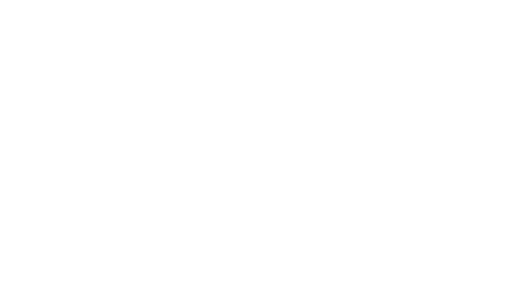

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 32ms/step


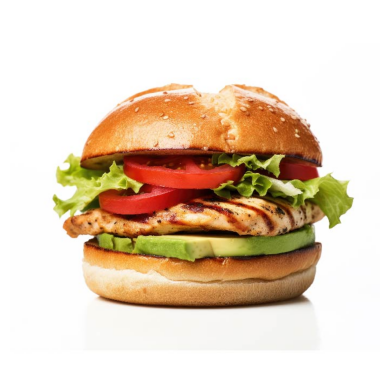

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 21ms/step


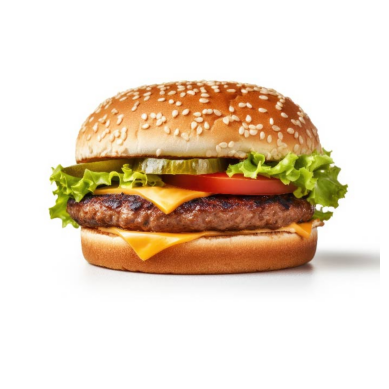

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 21ms/step


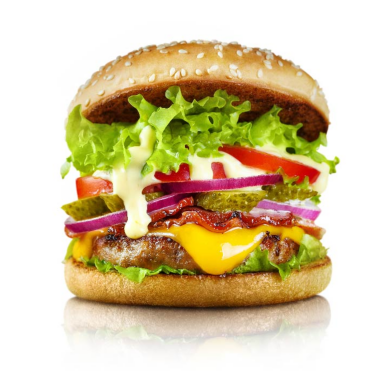

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 22ms/step


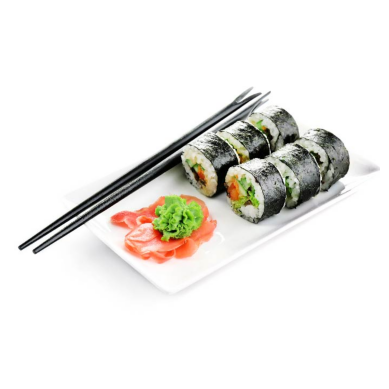

Predicted: Pizza, Pizza confidence: 0.7611, Sandwich confidence: 0.2389

1/1 [==============================] - 0s 22ms/step


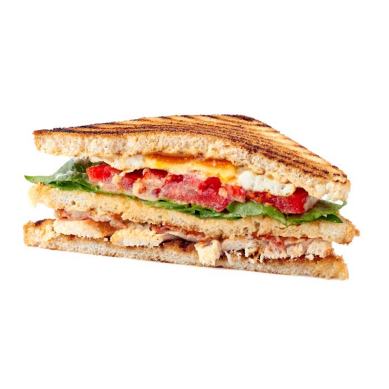

Predicted: Sandwich, Pizza confidence: 0.0001, Sandwich confidence: 0.9999

1/1 [==============================] - 0s 21ms/step


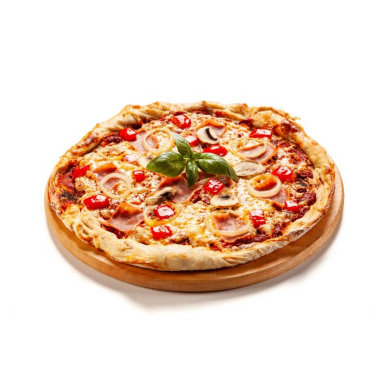

Predicted: Pizza, Pizza confidence: 0.9810, Sandwich confidence: 0.0190

1/1 [==============================] - 0s 22ms/step


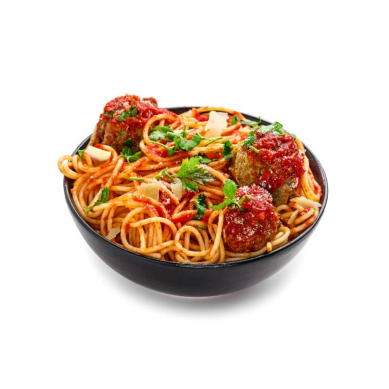

Predicted: Pizza, Pizza confidence: 0.7192, Sandwich confidence: 0.2808

1/1 [==============================] - 0s 21ms/step


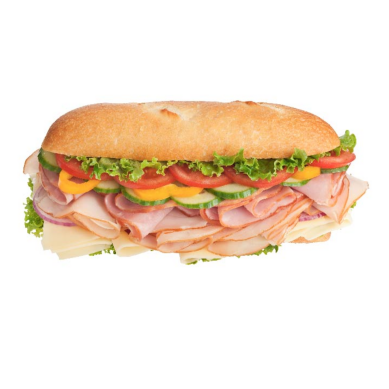

Predicted: Sandwich, Pizza confidence: 0.0070, Sandwich confidence: 0.9930

1/1 [==============================] - 0s 22ms/step


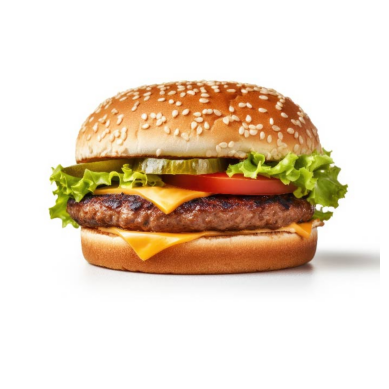

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 22ms/step


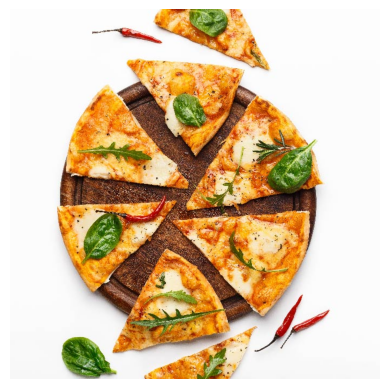

Predicted: Sandwich, Pizza confidence: 0.0042, Sandwich confidence: 0.9958

1/1 [==============================] - 0s 22ms/step


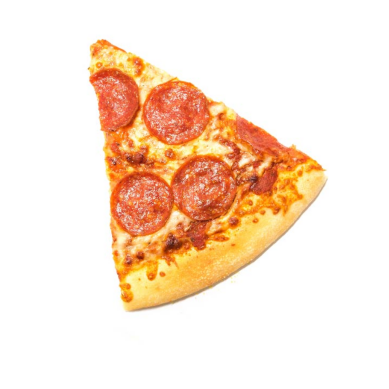

Predicted: Pizza, Pizza confidence: 0.7402, Sandwich confidence: 0.2598

1/1 [==============================] - 0s 22ms/step


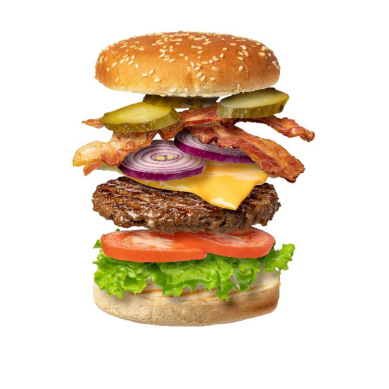

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 21ms/step


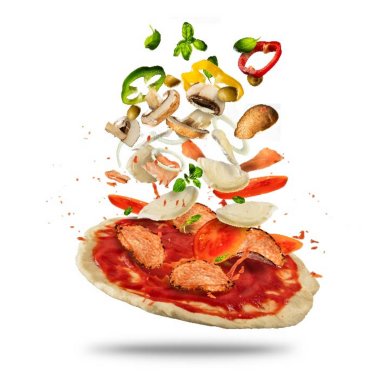

Predicted: Sandwich, Pizza confidence: 0.0639, Sandwich confidence: 0.9361

1/1 [==============================] - 0s 23ms/step


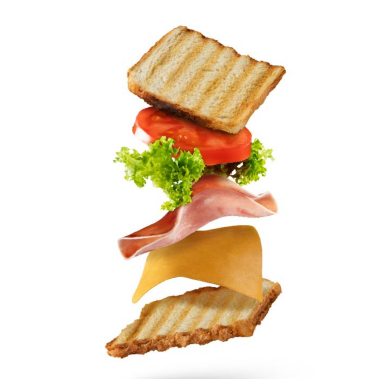

Predicted: Sandwich, Pizza confidence: 0.0234, Sandwich confidence: 0.9766

1/1 [==============================] - 0s 22ms/step


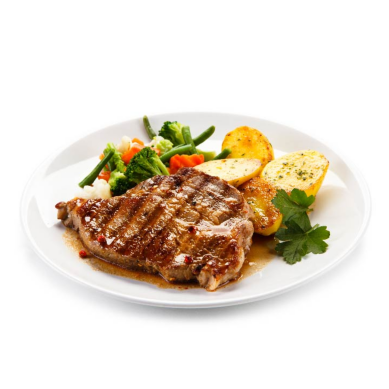

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 21ms/step


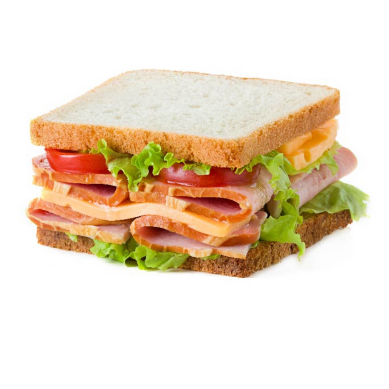

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 24ms/step


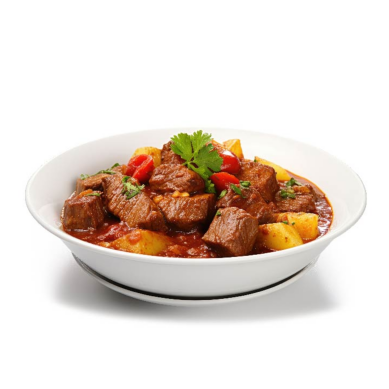

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 24ms/step


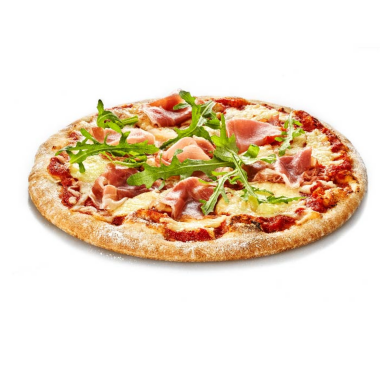

Predicted: Pizza, Pizza confidence: 0.9629, Sandwich confidence: 0.0371

1/1 [==============================] - 0s 23ms/step


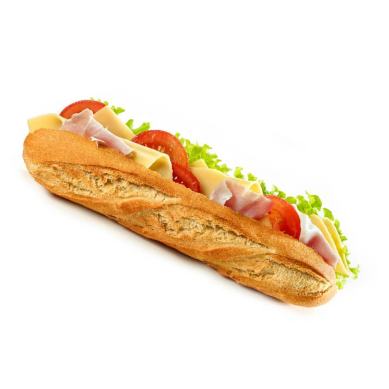

Predicted: Sandwich, Pizza confidence: 0.0498, Sandwich confidence: 0.9502

1/1 [==============================] - 0s 22ms/step


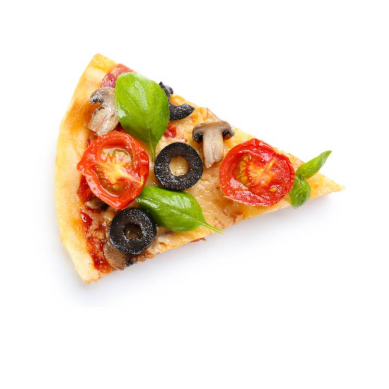

Predicted: Sandwich, Pizza confidence: 0.0032, Sandwich confidence: 0.9968

1/1 [==============================] - 0s 22ms/step


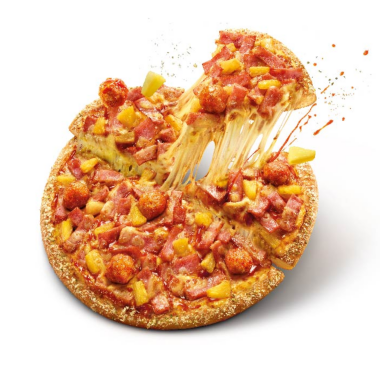

Predicted: Pizza, Pizza confidence: 0.9015, Sandwich confidence: 0.0985

1/1 [==============================] - 0s 21ms/step


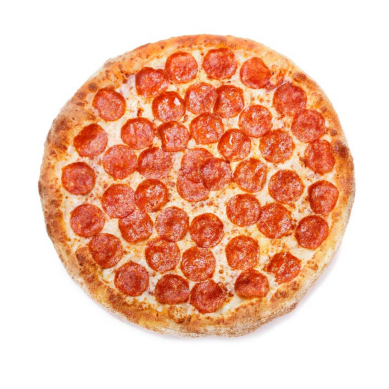

Predicted: Pizza, Pizza confidence: 1.0000, Sandwich confidence: 0.0000

1/1 [==============================] - 0s 22ms/step


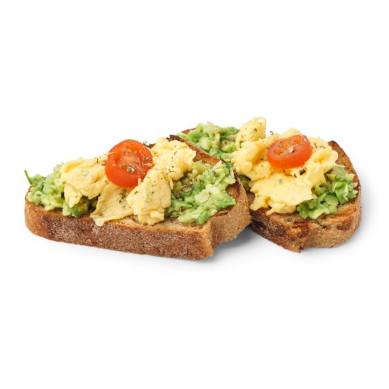

Predicted: Sandwich, Pizza confidence: 0.0282, Sandwich confidence: 0.9718

1/1 [==============================] - 0s 21ms/step


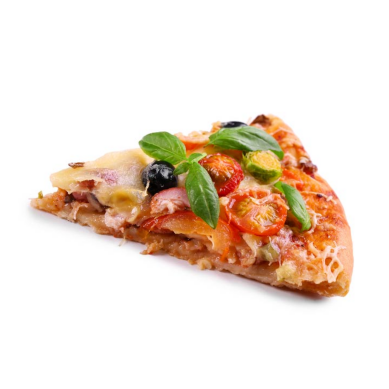

Predicted: Sandwich, Pizza confidence: 0.0127, Sandwich confidence: 0.9873

1/1 [==============================] - 0s 21ms/step


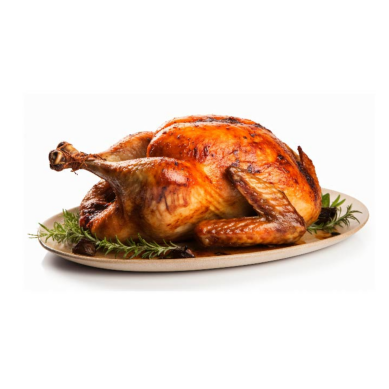

Predicted: Sandwich, Pizza confidence: 0.0014, Sandwich confidence: 0.9986

1/1 [==============================] - 0s 22ms/step


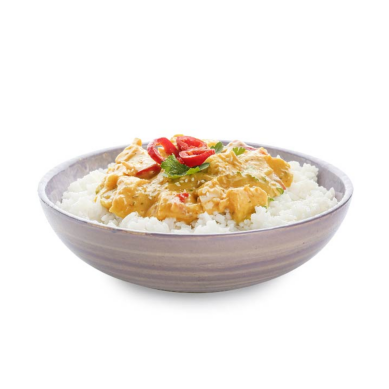

Predicted: Sandwich, Pizza confidence: 0.0957, Sandwich confidence: 0.9043

1/1 [==============================] - 0s 22ms/step


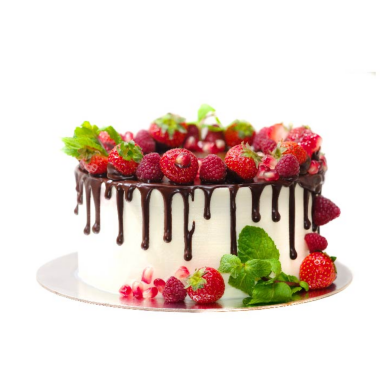

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 23ms/step


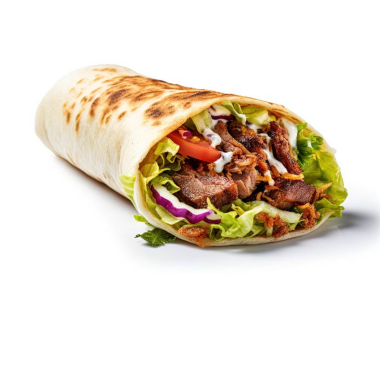

Predicted: Sandwich, Pizza confidence: 0.0542, Sandwich confidence: 0.9458

1/1 [==============================] - 0s 21ms/step


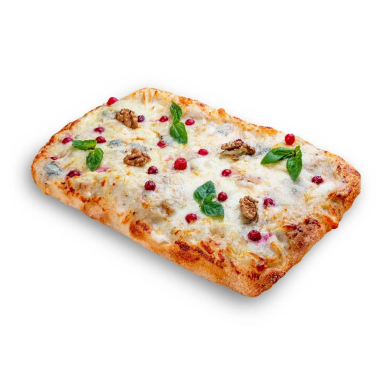

Predicted: Pizza, Pizza confidence: 0.6894, Sandwich confidence: 0.3106

1/1 [==============================] - 0s 22ms/step


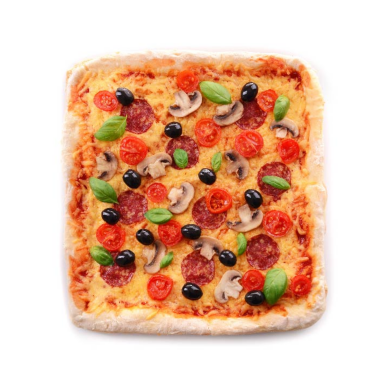

Predicted: Pizza, Pizza confidence: 0.9150, Sandwich confidence: 0.0850

1/1 [==============================] - 0s 21ms/step


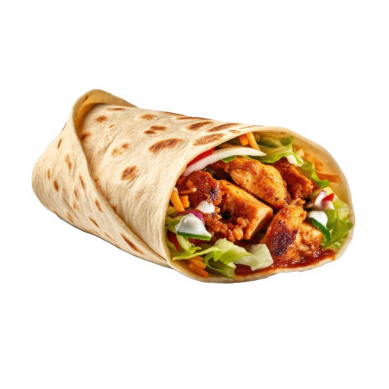

Predicted: Sandwich, Pizza confidence: 0.0038, Sandwich confidence: 0.9962

1/1 [==============================] - 0s 21ms/step


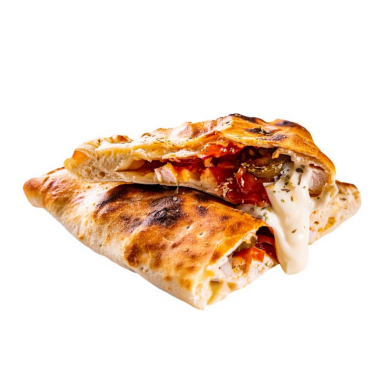

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 22ms/step


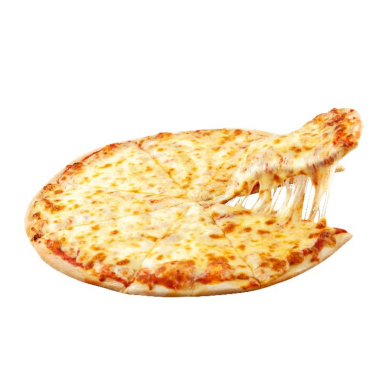

Predicted: Pizza, Pizza confidence: 0.8302, Sandwich confidence: 0.1698

1/1 [==============================] - 0s 22ms/step


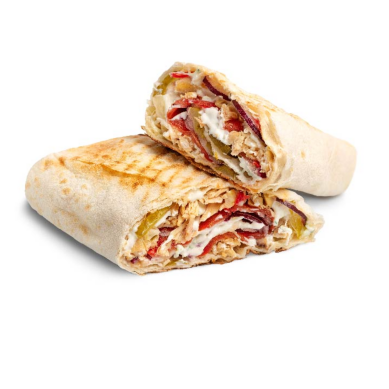

Predicted: Pizza, Pizza confidence: 0.9614, Sandwich confidence: 0.0386

1/1 [==============================] - 0s 22ms/step


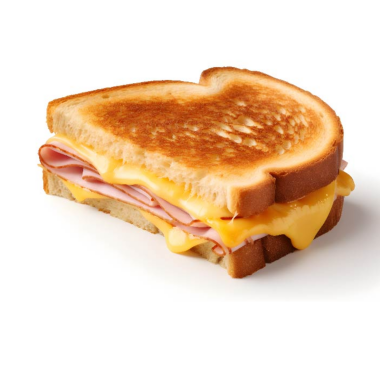

Predicted: Sandwich, Pizza confidence: 0.0133, Sandwich confidence: 0.9867

1/1 [==============================] - 0s 22ms/step


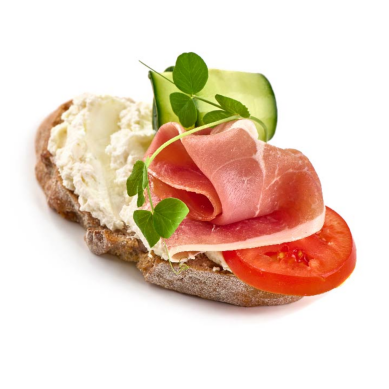

Predicted: Sandwich, Pizza confidence: 0.0016, Sandwich confidence: 0.9984

1/1 [==============================] - 0s 22ms/step


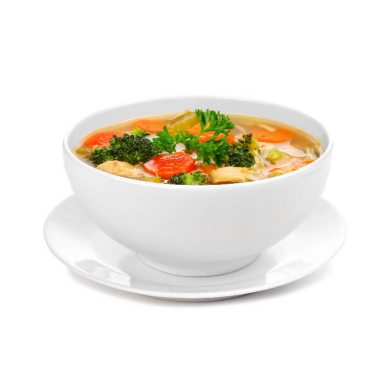

Predicted: Sandwich, Pizza confidence: 0.0004, Sandwich confidence: 0.9996

1/1 [==============================] - 0s 21ms/step


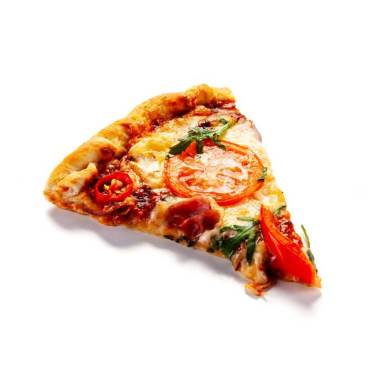

Predicted: Sandwich, Pizza confidence: 0.0061, Sandwich confidence: 0.9939

1/1 [==============================] - 0s 21ms/step


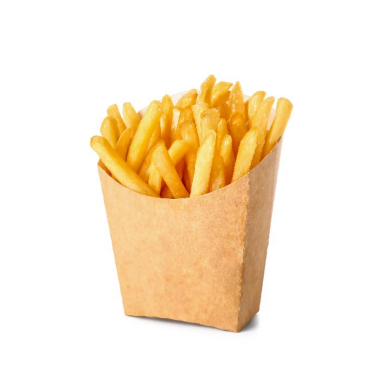

Predicted: Sandwich, Pizza confidence: 0.1434, Sandwich confidence: 0.8566

1/1 [==============================] - 0s 22ms/step


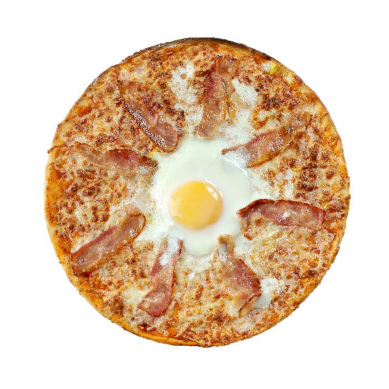

Predicted: Pizza, Pizza confidence: 0.9999, Sandwich confidence: 0.0001

1/1 [==============================] - 0s 21ms/step


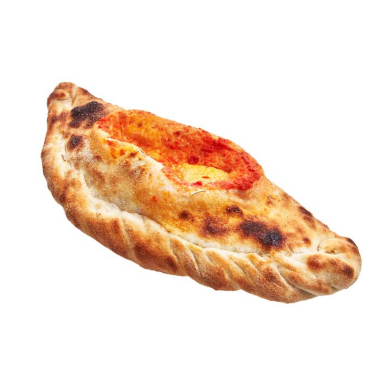

Predicted: Sandwich, Pizza confidence: 0.1543, Sandwich confidence: 0.8457

1/1 [==============================] - 0s 21ms/step


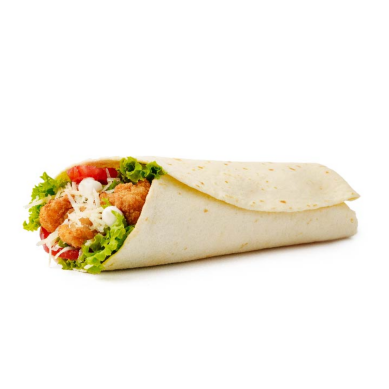

Predicted: Sandwich, Pizza confidence: 0.0021, Sandwich confidence: 0.9979

1/1 [==============================] - 0s 23ms/step


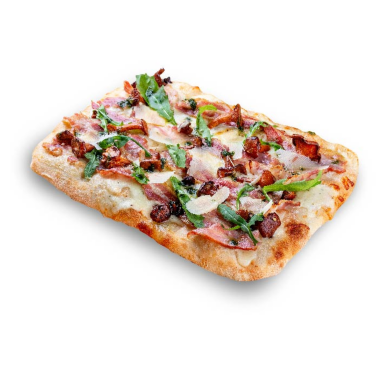

Predicted: Pizza, Pizza confidence: 0.9023, Sandwich confidence: 0.0977

1/1 [==============================] - 0s 21ms/step


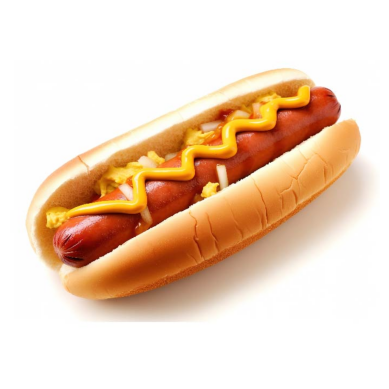

Predicted: Sandwich, Pizza confidence: 0.0057, Sandwich confidence: 0.9943

1/1 [==============================] - 0s 21ms/step


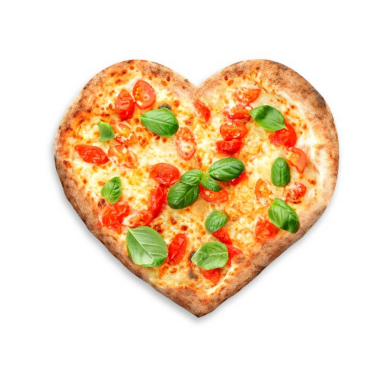

Predicted: Sandwich, Pizza confidence: 0.3344, Sandwich confidence: 0.6656

1/1 [==============================] - 0s 21ms/step


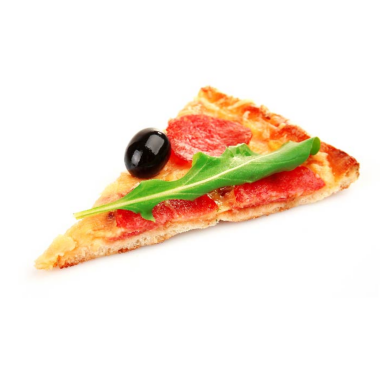

Predicted: Sandwich, Pizza confidence: 0.0138, Sandwich confidence: 0.9862

1/1 [==============================] - 0s 21ms/step


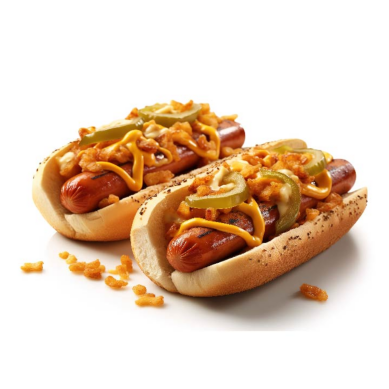

Predicted: Pizza, Pizza confidence: 0.5581, Sandwich confidence: 0.4419

1/1 [==============================] - 0s 27ms/step


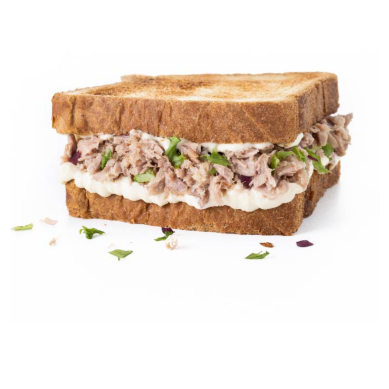

Predicted: Sandwich, Pizza confidence: 0.0818, Sandwich confidence: 0.9182

1/1 [==============================] - 0s 22ms/step


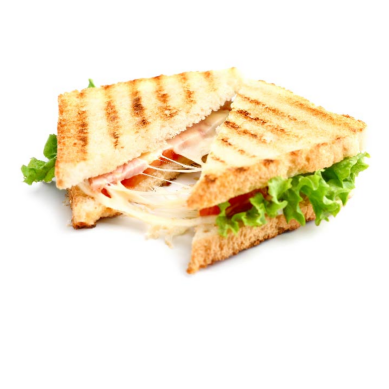

Predicted: Sandwich, Pizza confidence: 0.0003, Sandwich confidence: 0.9997

1/1 [==============================] - 0s 22ms/step


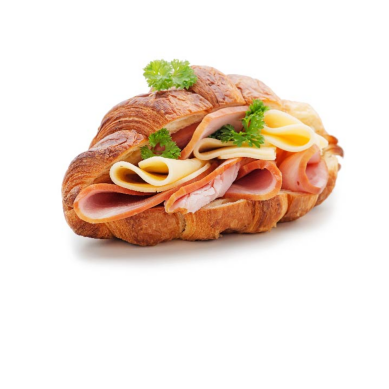

Predicted: Sandwich, Pizza confidence: 0.0027, Sandwich confidence: 0.9973

1/1 [==============================] - 0s 22ms/step


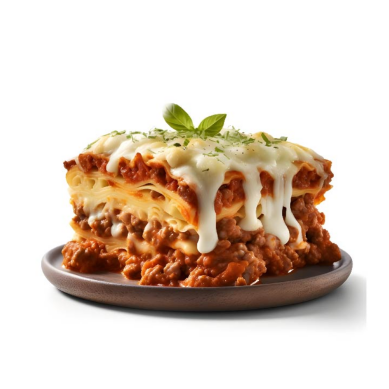

Predicted: Sandwich, Pizza confidence: 0.0004, Sandwich confidence: 0.9996

1/1 [==============================] - 0s 21ms/step


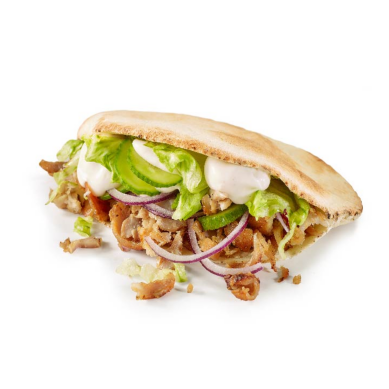

Predicted: Sandwich, Pizza confidence: 0.0001, Sandwich confidence: 0.9999

1/1 [==============================] - 0s 22ms/step


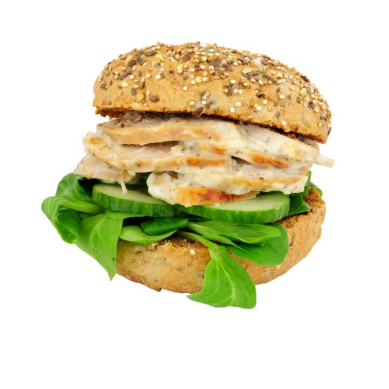

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 22ms/step


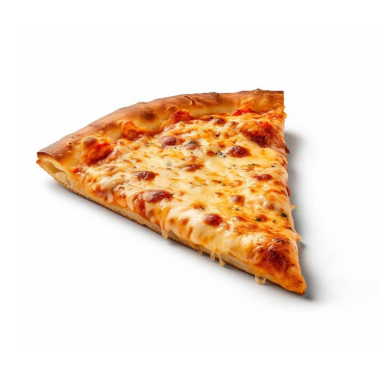

Predicted: Pizza, Pizza confidence: 0.8684, Sandwich confidence: 0.1316

1/1 [==============================] - 0s 21ms/step


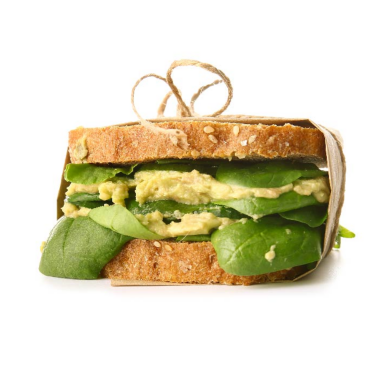

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 22ms/step


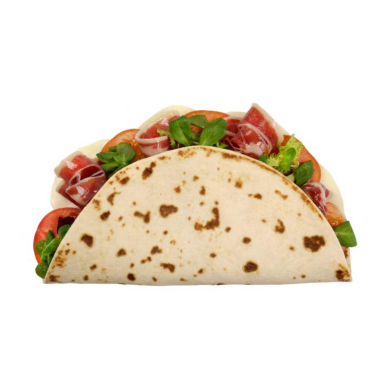

Predicted: Sandwich, Pizza confidence: 0.0004, Sandwich confidence: 0.9996

1/1 [==============================] - 0s 22ms/step


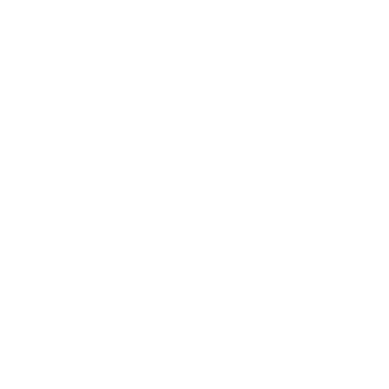

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 22ms/step


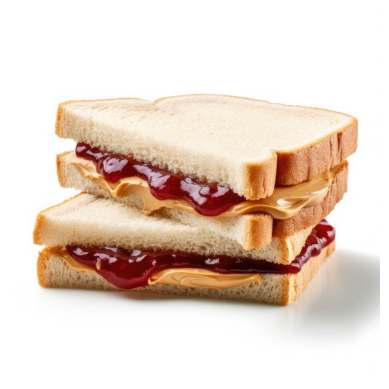

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 22ms/step


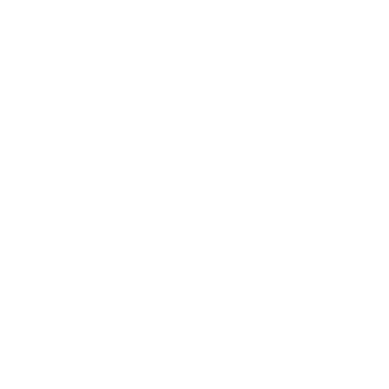

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 22ms/step


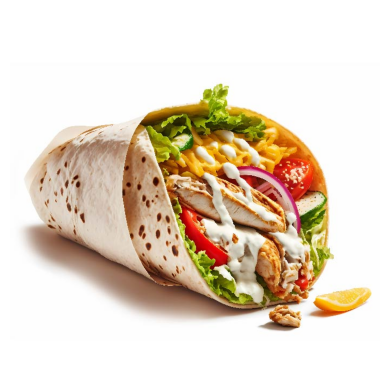

Predicted: Sandwich, Pizza confidence: 0.0096, Sandwich confidence: 0.9904

1/1 [==============================] - 0s 22ms/step


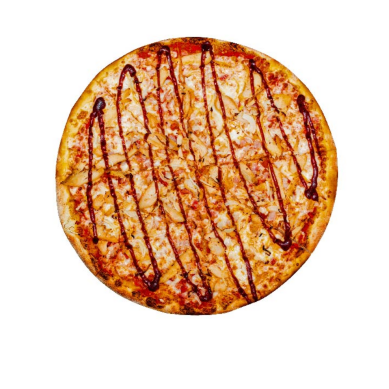

Predicted: Pizza, Pizza confidence: 1.0000, Sandwich confidence: 0.0000

1/1 [==============================] - 0s 22ms/step


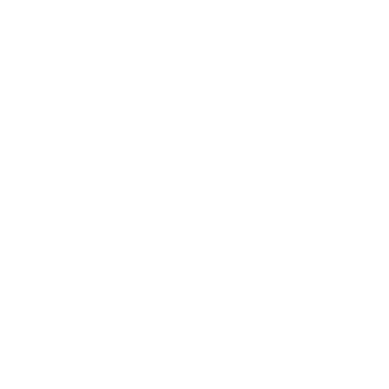

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 22ms/step


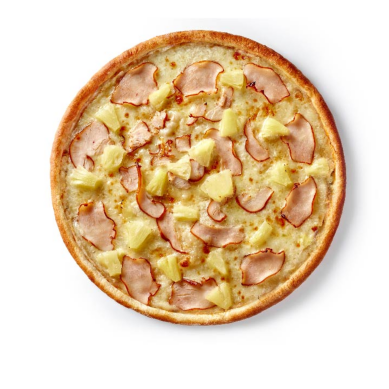

Predicted: Pizza, Pizza confidence: 0.9963, Sandwich confidence: 0.0037

1/1 [==============================] - 0s 22ms/step


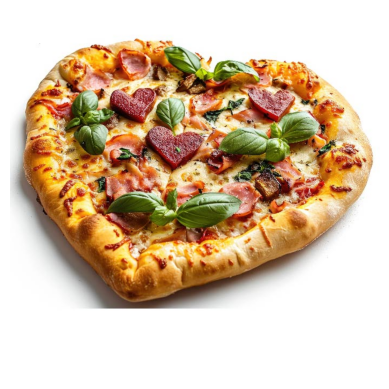

Predicted: Pizza, Pizza confidence: 0.9328, Sandwich confidence: 0.0672

1/1 [==============================] - 0s 21ms/step


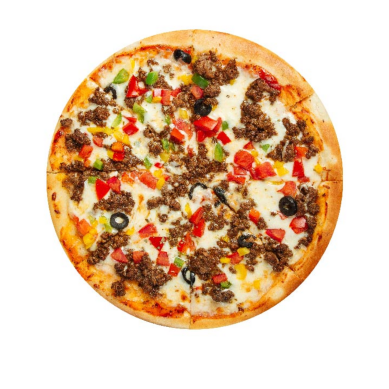

Predicted: Pizza, Pizza confidence: 1.0000, Sandwich confidence: 0.0000

1/1 [==============================] - 0s 21ms/step


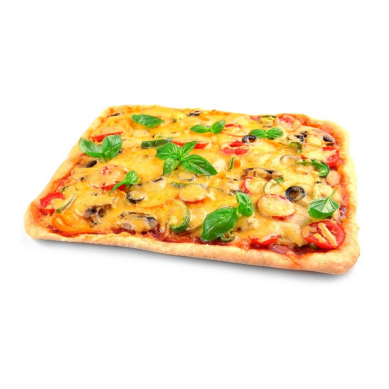

Predicted: Sandwich, Pizza confidence: 0.0006, Sandwich confidence: 0.9994

1/1 [==============================] - 0s 21ms/step


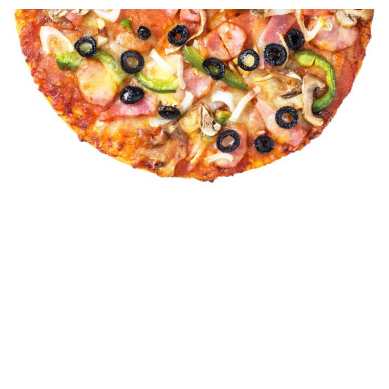

Predicted: Pizza, Pizza confidence: 0.8300, Sandwich confidence: 0.1700

1/1 [==============================] - 0s 22ms/step


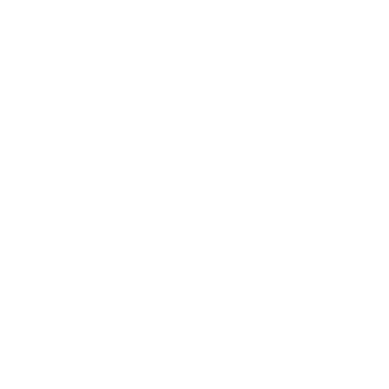

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 29ms/step


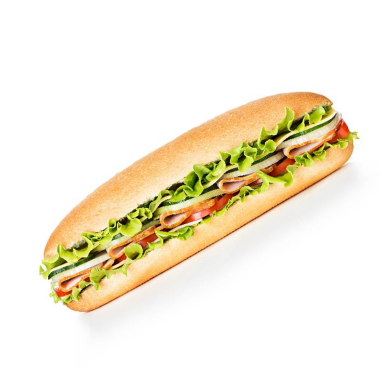

Predicted: Sandwich, Pizza confidence: 0.0046, Sandwich confidence: 0.9954

1/1 [==============================] - 0s 22ms/step


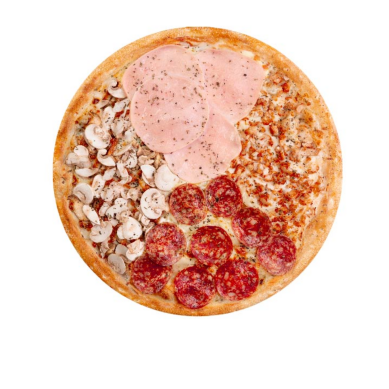

Predicted: Pizza, Pizza confidence: 0.9966, Sandwich confidence: 0.0034

1/1 [==============================] - 0s 22ms/step


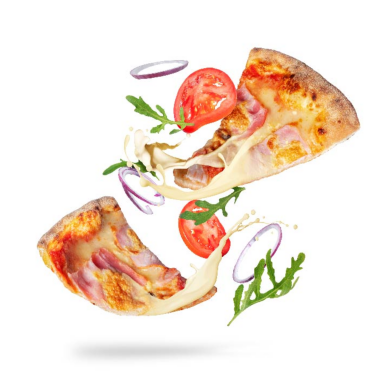

Predicted: Pizza, Pizza confidence: 0.8930, Sandwich confidence: 0.1070

1/1 [==============================] - 0s 22ms/step


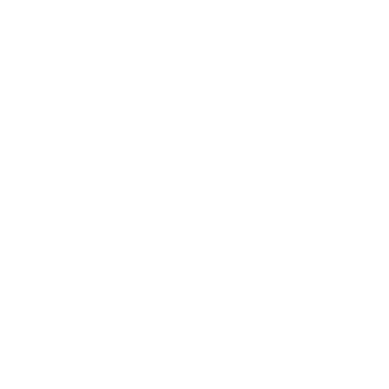

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 24ms/step


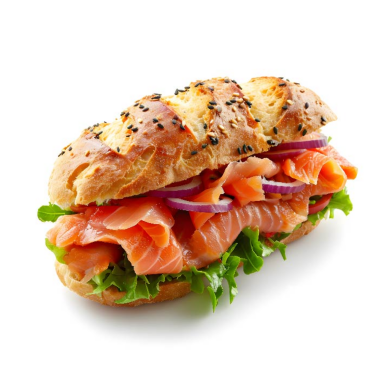

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 23ms/step


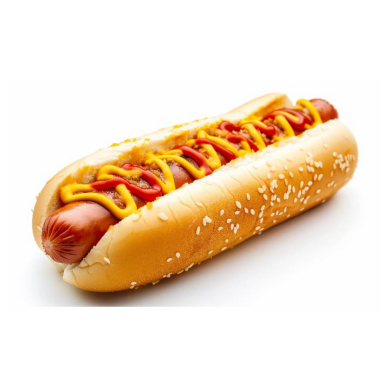

Predicted: Sandwich, Pizza confidence: 0.0189, Sandwich confidence: 0.9811

1/1 [==============================] - 0s 22ms/step


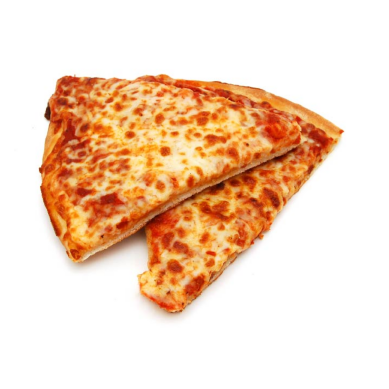

Predicted: Pizza, Pizza confidence: 0.6773, Sandwich confidence: 0.3227

1/1 [==============================] - 0s 22ms/step


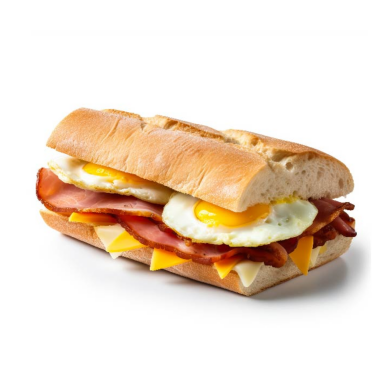

Predicted: Sandwich, Pizza confidence: 0.0001, Sandwich confidence: 0.9999

1/1 [==============================] - 0s 27ms/step


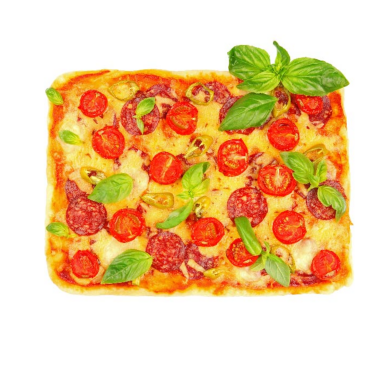

Predicted: Sandwich, Pizza confidence: 0.0159, Sandwich confidence: 0.9841

1/1 [==============================] - 0s 27ms/step


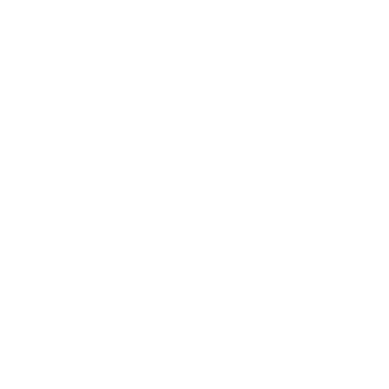

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 22ms/step


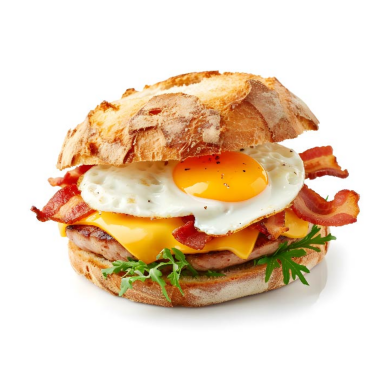

Predicted: Sandwich, Pizza confidence: 0.0002, Sandwich confidence: 0.9998

1/1 [==============================] - 0s 22ms/step


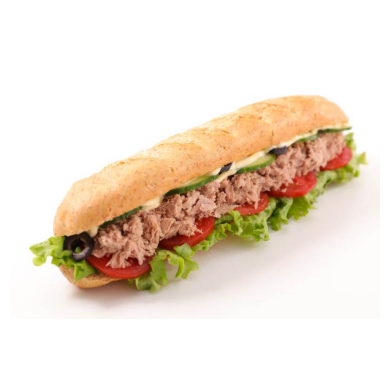

Predicted: Sandwich, Pizza confidence: 0.0015, Sandwich confidence: 0.9985

1/1 [==============================] - 0s 21ms/step


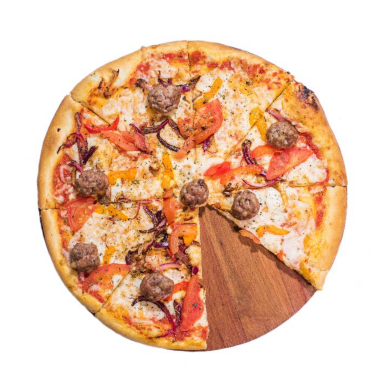

Predicted: Pizza, Pizza confidence: 1.0000, Sandwich confidence: 0.0000

1/1 [==============================] - 0s 22ms/step


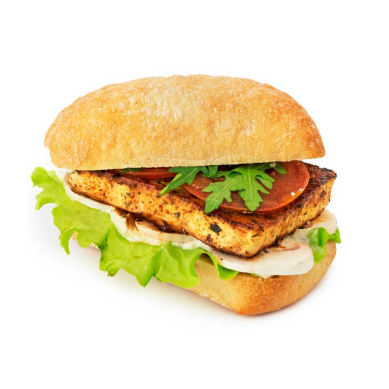

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 23ms/step


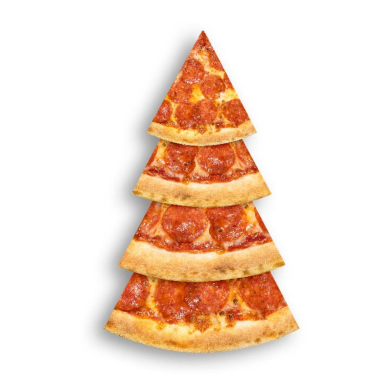

Predicted: Pizza, Pizza confidence: 0.8946, Sandwich confidence: 0.1054

1/1 [==============================] - 0s 22ms/step


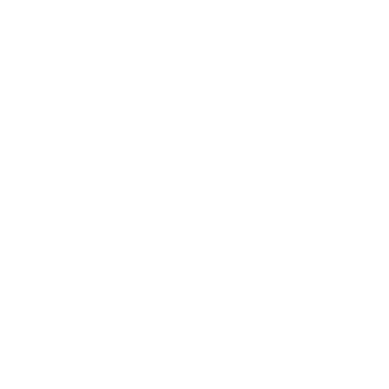

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 22ms/step


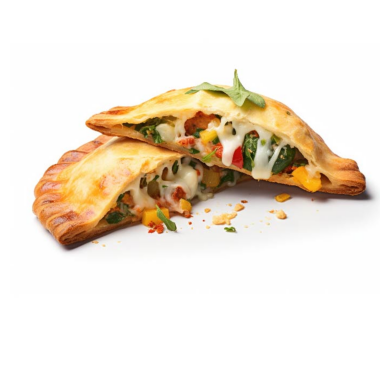

Predicted: Sandwich, Pizza confidence: 0.0586, Sandwich confidence: 0.9414

1/1 [==============================] - 0s 21ms/step


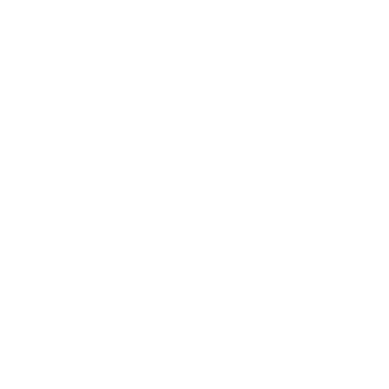

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 21ms/step


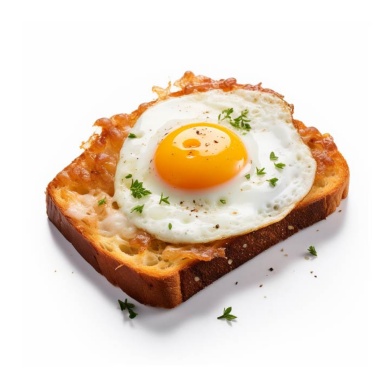

Predicted: Sandwich, Pizza confidence: 0.1040, Sandwich confidence: 0.8960

1/1 [==============================] - 0s 23ms/step


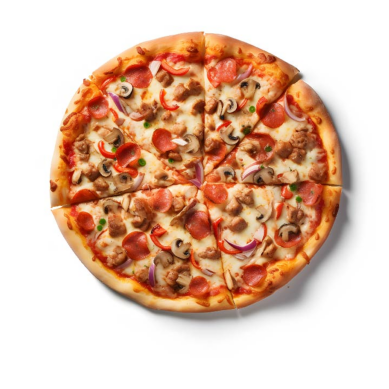

Predicted: Pizza, Pizza confidence: 0.9998, Sandwich confidence: 0.0002

1/1 [==============================] - 0s 23ms/step


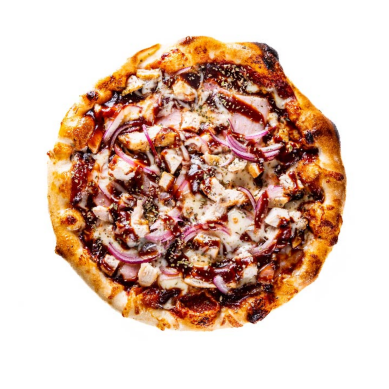

Predicted: Pizza, Pizza confidence: 1.0000, Sandwich confidence: 0.0000

1/1 [==============================] - 0s 22ms/step


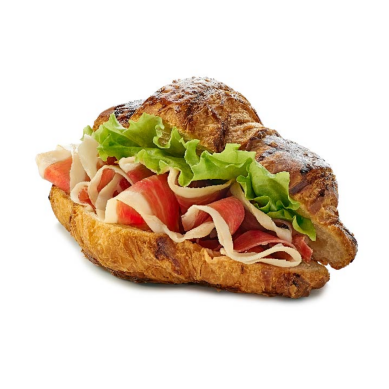

Predicted: Sandwich, Pizza confidence: 0.0454, Sandwich confidence: 0.9546

1/1 [==============================] - 0s 22ms/step


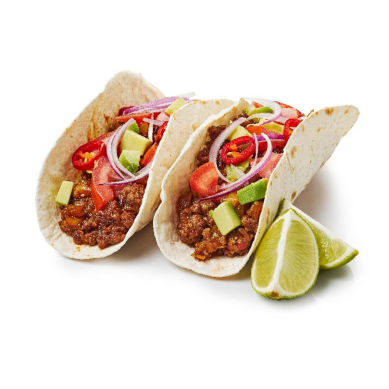

Predicted: Pizza, Pizza confidence: 0.6116, Sandwich confidence: 0.3884

1/1 [==============================] - 0s 21ms/step


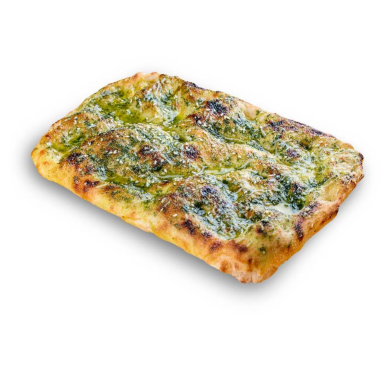

Predicted: Pizza, Pizza confidence: 0.7028, Sandwich confidence: 0.2972

1/1 [==============================] - 0s 22ms/step


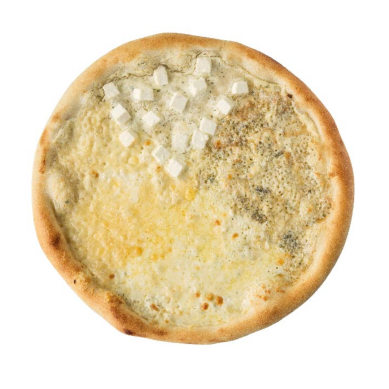

Predicted: Pizza, Pizza confidence: 0.8707, Sandwich confidence: 0.1293

1/1 [==============================] - 0s 21ms/step


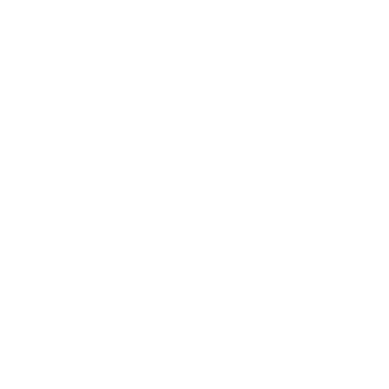

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857

1/1 [==============================] - 0s 22ms/step


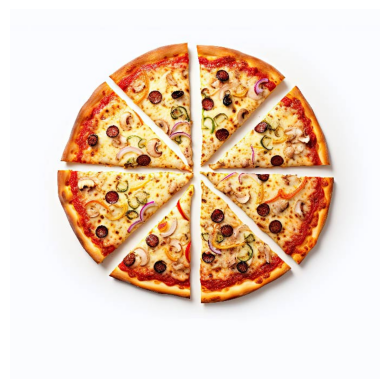

Predicted: Pizza, Pizza confidence: 0.9999, Sandwich confidence: 0.0001

1/1 [==============================] - 0s 22ms/step


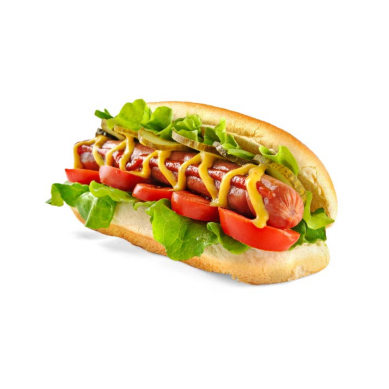

Predicted: Sandwich, Pizza confidence: 0.0000, Sandwich confidence: 1.0000

1/1 [==============================] - 0s 28ms/step


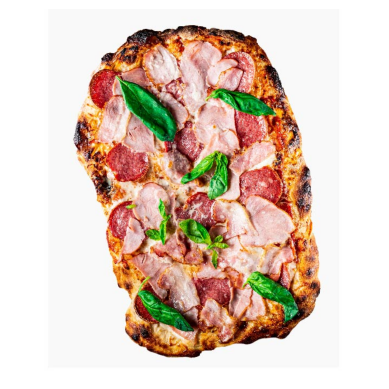

Predicted: Pizza, Pizza confidence: 0.9962, Sandwich confidence: 0.0038

1/1 [==============================] - 0s 22ms/step


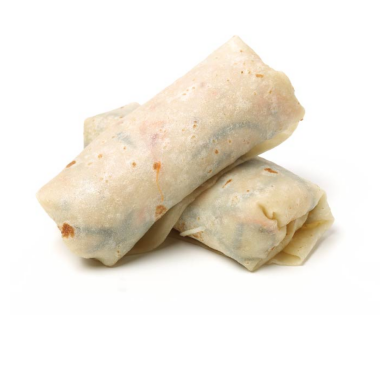

Predicted: Sandwich, Pizza confidence: 0.0284, Sandwich confidence: 0.9716

1/1 [==============================] - 0s 21ms/step


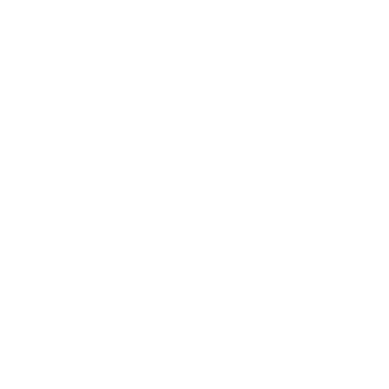

Predicted: Sandwich, Pizza confidence: 0.2143, Sandwich confidence: 0.7857



In [ ]:
# Path to your images
image_directory = '/content/drive/MyDrive/Trial'

# Load image paths
image_paths = [os.path.join(image_directory, img) for img in os.listdir(image_directory)[:100]]  # Limit to 100 images

def preprocess_image(image_path, target_size=(150, 150)):
    """Load and preprocess an image."""
    img = load_img(image_path, target_size=target_size)
    img_array = img_to_array(img)
    img_array_expanded_dims = np.expand_dims(img_array, axis=0)
    return img_array_expanded_dims / 255.  # Rescale pixel values

for image_path in image_paths:
    processed_image = preprocess_image(image_path)

    # Predict
    prediction = model.predict(processed_image)
    sandwich_confidence = prediction[0][0]
    pizza_confidence = 1 - sandwich_confidence  # Since it's binary classification

    # Display the image
    plt.imshow(Image.open(image_path))
    plt.axis('off')
    plt.show()

    # Display classification and confidence
    predicted_class = 'Sandwich' if sandwich_confidence > 0.5 else 'Pizza'
    print(f'Predicted: {predicted_class}, Pizza confidence: {pizza_confidence:.4f}, Sandwich confidence: {sandwich_confidence:.4f}\n')

## Load Exhibit Image

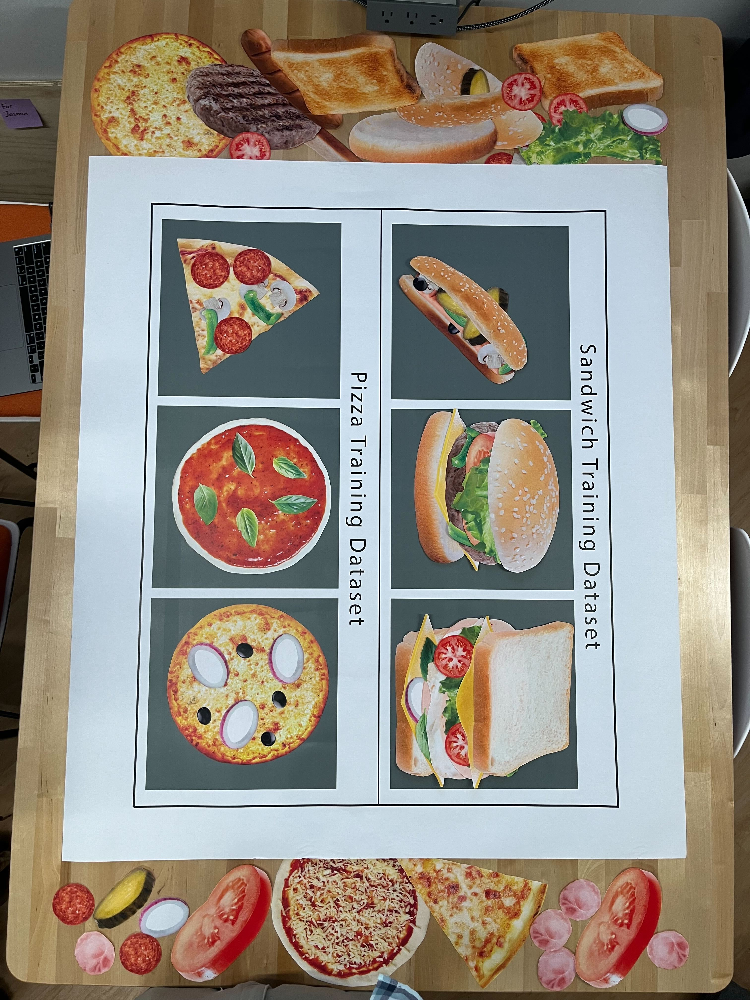

In [ ]:
# Load the image
image_trial = Image.open('/content/drive/MyDrive/PizzaOrSandwich/TrialImage.jpg')
display(image_trial)

## Extract 6 Individual Images

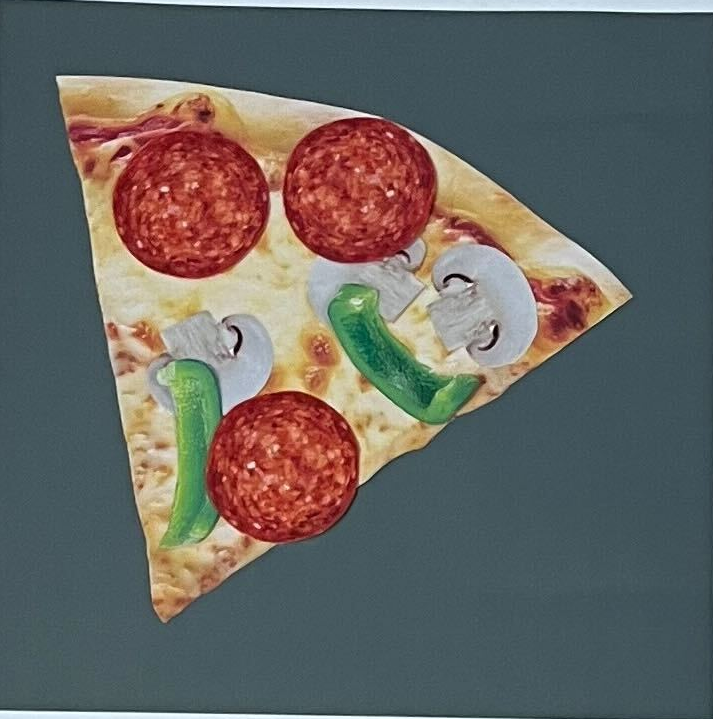

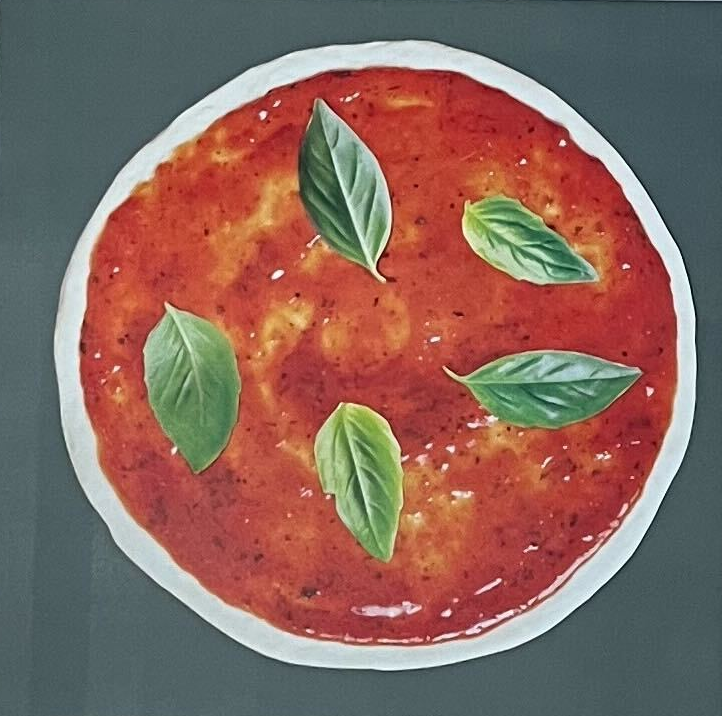

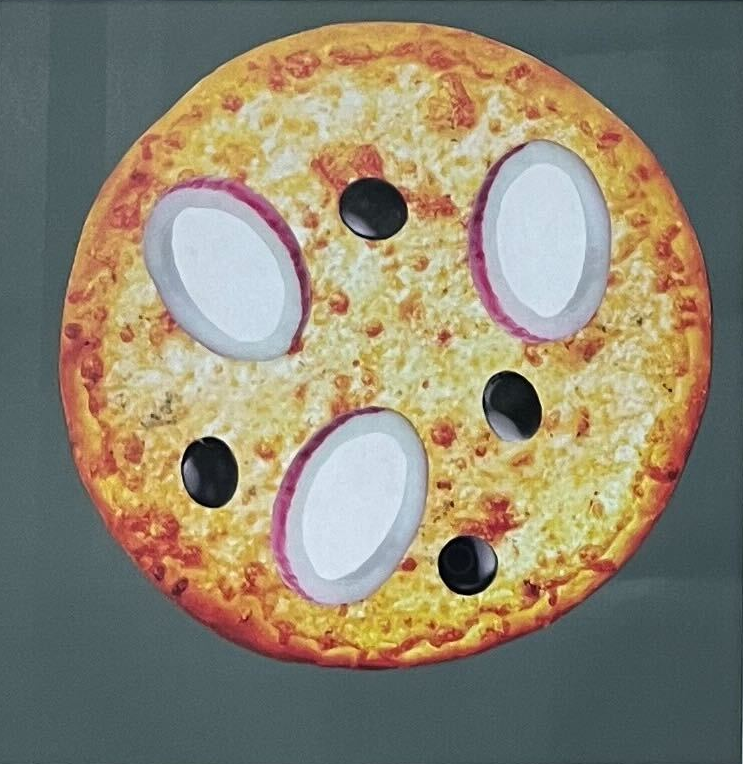

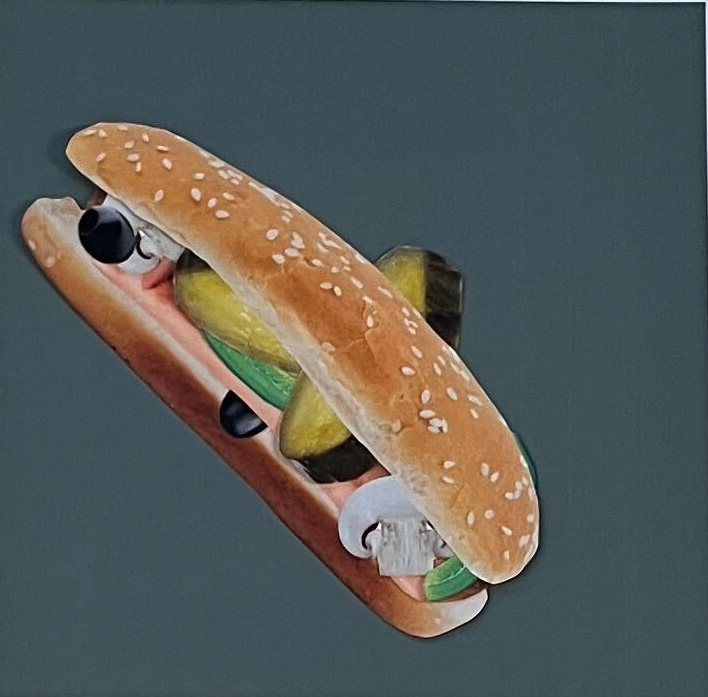

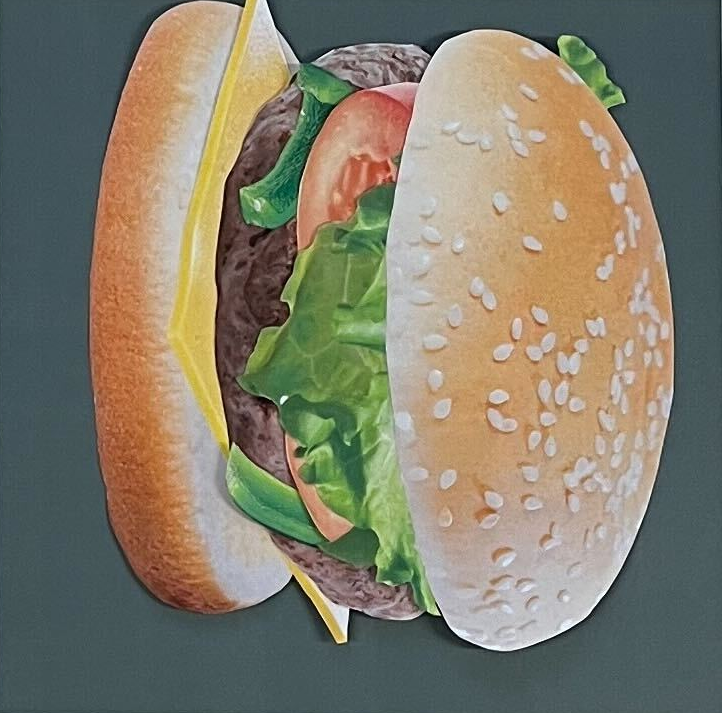

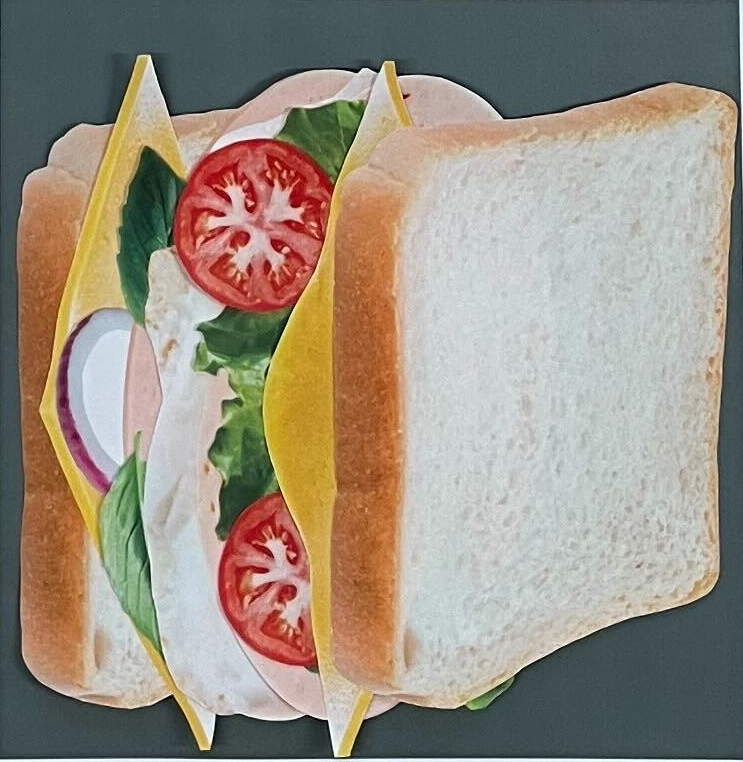

In [ ]:
# Define the coordinates of the 6 regions to extract
# Format: [(x1, y1, x2, y2), ...]
regions = [
    (657, 886, 1370, 1605),  # Corrected coordinates for the first image
    (638, 1645, 1360, 2361),  # Corrected for the second, and so on
    (614, 2414, 1357, 3178),
    (1587, 910, 2295, 1607),
    (1581, 1658, 2303, 2371),
    (1576, 2422, 2319, 3184)
]

specific_image_paths = [
    'pizza_image_1.jpg',
    'pizza_image_2.jpg',
    'pizza_image_3.jpg',
    'sandwich_image_1.jpg',
    'sandwich_image_2.jpg',
    'sandwich_image_3.jpg'
]

# Extract and save/display each region
extracted_images = []
for i, region in enumerate(regions):
    # Crop the image according to the region
    cropped_image = image_trial.crop(region)
    cropped_image.save(specific_image_paths[i])
    extracted_images.append(cropped_image)

    # Display the cropped image (optional)
    display(cropped_image)

## Extracting Relevant Features
Re-training Model on New Features

In [ ]:
# Assuming `model` is your trained Keras model
feature_extractor = Model(inputs=model.inputs, outputs=model.layers[-2].output)  # Adjust the layer index based on your model

def extract_features(image_path, feature_extractor):
    processed_image = preprocess_image(image_path)
    features = feature_extractor.predict(processed_image)
    # Flatten the features to make it a 2D array
    features_flattened = features.flatten()[np.newaxis, :]
    return features_flattened

# Now, when you extract features for each specific image, ensure that the array is structured correctly.
specific_features = np.array([extract_features(img_path, feature_extractor) for img_path in specific_image_paths])

# Since we're adding a new axis in `extract_features`, `specific_features` might end up being 3D. We need it to be 2D:
# (number of images, features)
specific_features = np.squeeze(specific_features)

# Ensure specific_features is 2D
if specific_features.ndim > 2:
    specific_features = specific_features.reshape((specific_features.shape[0], -1))

1/1 [==============================] - 0s 21ms/step


## Testing Trial Image
Calculating Confidence of Image

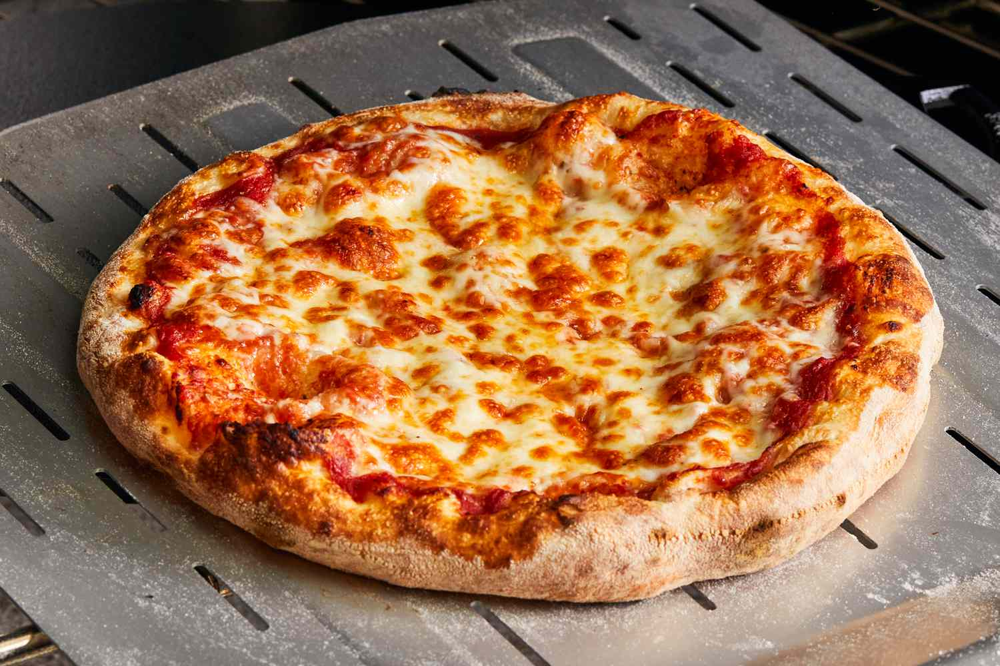

1/1 [==============================] - 0s 33ms/step
Predicted Class: Pizza, Confidence: {'Pizza': 0.5490084, 'Sandwich': 0.25031722}


In [ ]:
# Function to predict class based on similarity
def predict_class(new_image_path, specific_features, feature_extractor):
    new_image_features = extract_features(new_image_path, feature_extractor)

    # Calculate similarity of the new image to each specific image
    similarities = cosine_similarity(new_image_features, specific_features).flatten()

    # Average the similarities by class (pizza vs. sandwich)
    pizza_similarity = np.mean(similarities[:3])  # First 3 are pizzas
    sandwich_similarity = np.mean(similarities[3:])  # Last 3 are sandwiches

    # Assign confidence based on similarity scores
    confidence = {"Pizza": pizza_similarity, "Sandwich": sandwich_similarity}
    predicted_class = "Pizza" if pizza_similarity > sandwich_similarity else "Sandwich"

    return predicted_class, confidence

# Predict class for a new image
new_image_path = '/content/drive/MyDrive/PizzaOrSandwich/pizza0.jpeg'
display(Image.open(new_image_path))
predicted_class, confidence = predict_class(new_image_path, specific_features, feature_extractor)
print(f"Predicted Class: {predicted_class}, Confidence: {confidence}")

## Calculating Confidence of Set Output Images

In [ ]:
image_directory = '/content/drive/MyDrive/Trial'
image_paths = [os.path.join(image_directory, filename) for filename in os.listdir(image_directory) if filename.lower().endswith(('.png', '.jpg', '.jpeg'))]

def predict_class(image_path, specific_features, feature_extractor):
    new_image_features = extract_features(image_path, feature_extractor)
    # Calculate similarity of the new image to each specific image
    similarities = cosine_similarity(new_image_features, specific_features).flatten()
    # Average the similarities by class (pizza vs. sandwich)
    pizza_similarity = np.mean(similarities[:3])  # First 3 are pizzas
    sandwich_similarity = np.mean(similarities[3:])  # Last 3 are sandwiches
    confidence = {"Pizza": pizza_similarity, "Sandwich": sandwich_similarity}
    predicted_class = "Pizza" if pizza_similarity > sandwich_similarity else "Sandwich"
    return predicted_class, confidence, image_path

# Collect detailed results for all images
detailed_results = []
for image_path in image_paths:
    try:
        predicted_class, confidence, image_path = predict_class(image_path, specific_features, feature_extractor)
        detailed_results.append((image_path, predicted_class, confidence))
    except Exception as e:
        print(f"Error processing {image_path}: {e}")

1/1 [==============================] - 0s 21ms/step


## Displaying Final Output Images


Top 5 Pizza Images by Confidence:


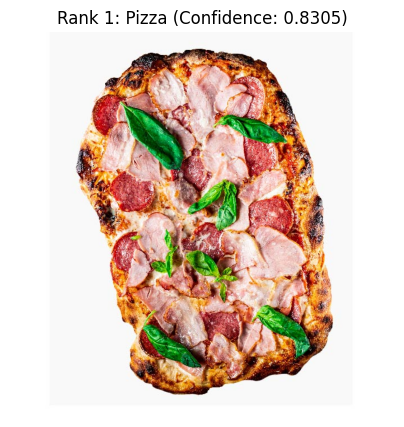

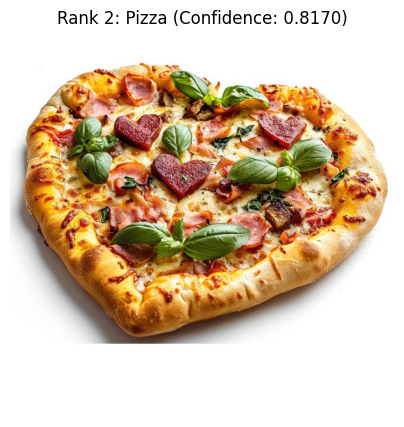

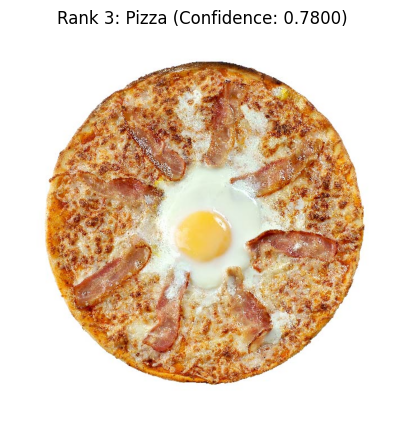

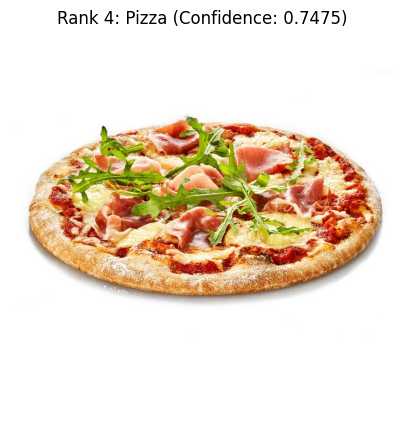

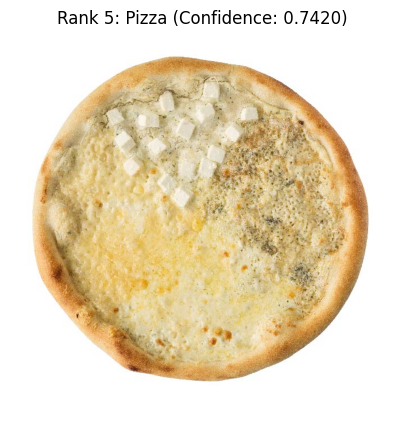


Top 5 Sandwich Images by Confidence:


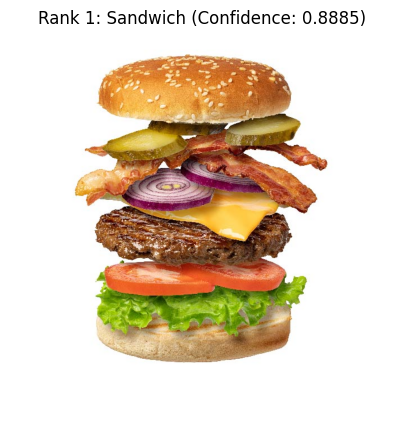

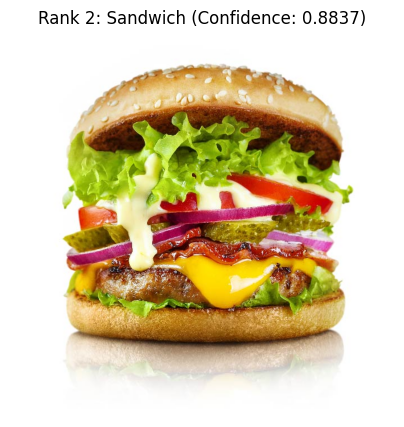

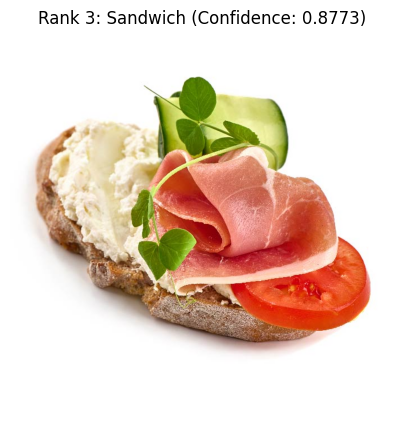

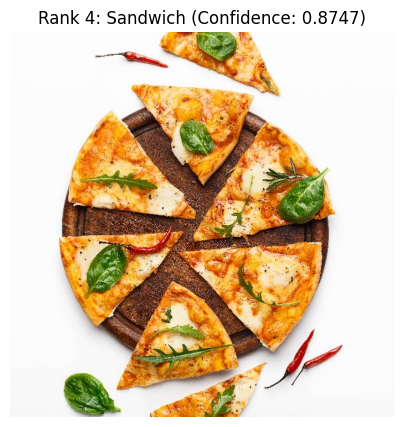

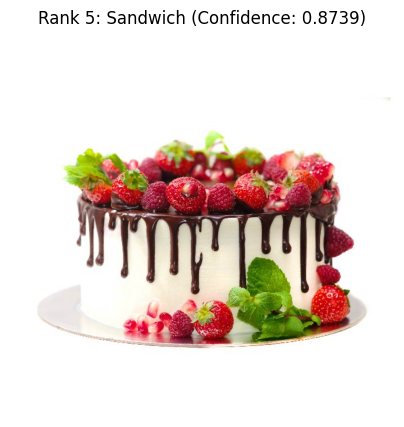

In [ ]:
# Separate results by class
pizza_results = [result for result in detailed_results if result[1] == "Pizza"]
sandwich_results = [result for result in detailed_results if result[1] == "Sandwich"]

# Sort by confidence (descending)
pizza_sorted = sorted(pizza_results, key=lambda x: x[2]["Pizza"], reverse=True)
sandwich_sorted = sorted(sandwich_results, key=lambda x: x[2]["Sandwich"], reverse=True)

# Function to display images
def display_top_images(sorted_results, category, top_n=5):
    print(f"\nTop {top_n} {category} Images by Confidence:")
    for i, (path, _, confidence) in enumerate(sorted_results[:top_n], 1):
        img = Image.open(path)
        plt.figure(figsize=(5, 5))
        plt.imshow(img)
        plt.title(f"Rank {i}: {category} (Confidence: {confidence[category]:.4f})")
        plt.axis('off')
        plt.show()

# Display top 5 images for Pizza and Sandwich
display_top_images(pizza_sorted, "Pizza")
display_top_images(sandwich_sorted, "Sandwich")


In [ ]:
model.save('model.h5')  # or model.save('saved_model/my_model')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model
model = load_model('model.h5')

In [ ]:
pip install Flask

In [ ]:
from flask import Flask, request, jsonify
app = Flask(__name__)

In [ ]:
@app.route('/predict', methods=['POST'])
def predict():
    if 'file' not in request.files:
        return jsonify({'error': 'No file provided'}), 400
    file = request.files['file']
    image = Image.open(file.stream).convert('RGB')
    image = image.resize((150, 150))
    image = np.array(image)
    image = np.expand_dims(image, axis=0) / 255.0  # Normalize

    # Your model prediction logic here
    predictions = model.predict(image)
    # Convert predictions to meaningful results

    return jsonify({'message': 'Success', 'predictions': predictions.tolist()})

In [ ]:
pip install flask-cors

In [ ]:
if __name__ == '__main__':
    app.run(debug=True, port=5000)  # Runs on http://localhost:5000

 * Serving Flask app '__main__'
 * Debug mode: on


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on http://127.0.0.1:5000
INFO:werkzeug:Press CTRL+C to quit
INFO:werkzeug: * Restarting with stat
